In [1]:
import scvelo as scv
import scanpy as sc
import cellrank as cr
import numpy as np
import pandas as pd
import anndata as ad
import scipy as sci
import matplotlib.pyplot as plt

import os

In [2]:
sc.settings.set_figure_params(dpi_save=300, facecolor="white", frameon=False, figsize=(10, 10))


plt.rcParams['axes.grid'] = False
plt.rcParams['pdf.fonttype'] = 42
plt.rcParams['ps.fonttype'] = 42


In [3]:
sc.settings.figdir = "fig5"


In [4]:
scv.settings.figdir = "fig5"


In [5]:
adata=sc.read_h5ad('/lustre/scratch126/cellgen/team298/ls34/adata_all.scvelo.preppedall3.lesionalonly2.3.integrated.moments2.plottedvelo2.renamed_v2')


In [6]:
RENAME = {'F2/3: Stroma_PPARG+': 'F2/3: Perivascular'}

adata.obs["test2"]=adata.obs["test2"].map(RENAME).fillna(adata.obs["test2"])

Error: Missing color for category 'F6: Myofibroblast inflammatory'


<Axes: xlabel='UMAP1', ylabel='UMAP2'>

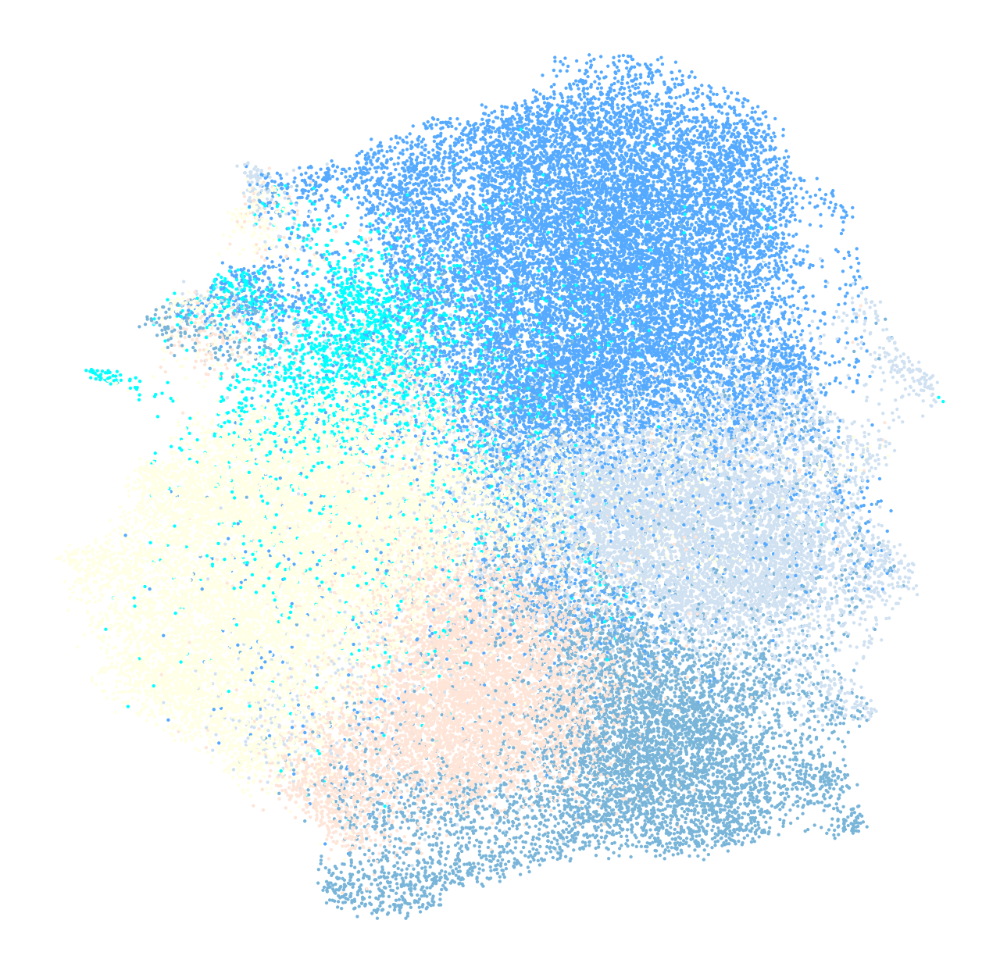

In [7]:
custom_colors = {'F1: Superficial': np.array([1.        , 1.        , 0.89803922, 1.        ]),
 'F1: EA-Regenerative': np.array([0.99607843, 0.80915033, 0.39607843, 1.        ]),
 'F2: Universal': np.array([0.81411765, 0.88392157, 0.94980392, 1.        ]),
 'F2/3: Perivascular': np.array([0.47294118, 0.71163399, 0.85071895, 1.        ]),
 'F3: FRC-like': np.array([0.99692426, 0.89619377, 0.84890427, 1.        ]),
 'F4: DS_DPEP1+': np.array([0.82745098, 0.93254902, 0.80313725, 1.        ]),
 'F4: TNN+COCH+': np.array([0.50196078, 0.79058824, 0.50143791, 1.        ]),
 'F4: DP_HHIP+': np.array([0.15294118, 0.56183007, 0.28313725, 1.        ]),
 'F5: RAMP1+':np.array([0.6177624 , 0.60213764, 0.78345252, 1.        ]),
 'F5: NGFR+': np.array([0.47320261, 0.43267974, 0.69934641, 1.        ]),
 'F6: Inflammatory myofibroblast': np.array([0., 1., 1., 1.]),
 'F6: Myofibroblast': np.array([0.33333333, 0.66666667, 1.        , 1.        ]),
 'F7: Fascia-like myofibroblast': np.array([0.95686275, 0.55686275, 0.74509804, 1.0]),
 'F_Fascia': np.array([0, 0, 0, 0.3])
                               }

adata.obs["test2"]=adata.obs["test2"].astype('category')
try:
    adata.uns["test2_colors"] = [custom_colors[cat] for cat in adata.obs["test2"].cat.categories]
except KeyError as e:
    print(f"Error: Missing color for category {e}")
sc.pl.umap(
    adata,
    color='test2',
    show=False,
    frameon=False,
    legend_loc=None, # "on data",
    legend_fontsize=5,
    s=15,
    title='',
    legend_fontoutline=2
)

 

figure cannot be saved as pdf, using png instead (can only output finite numbers in pdf).
saving figure to file fig5/scvelo_SUPP_fig5c_velocity.png


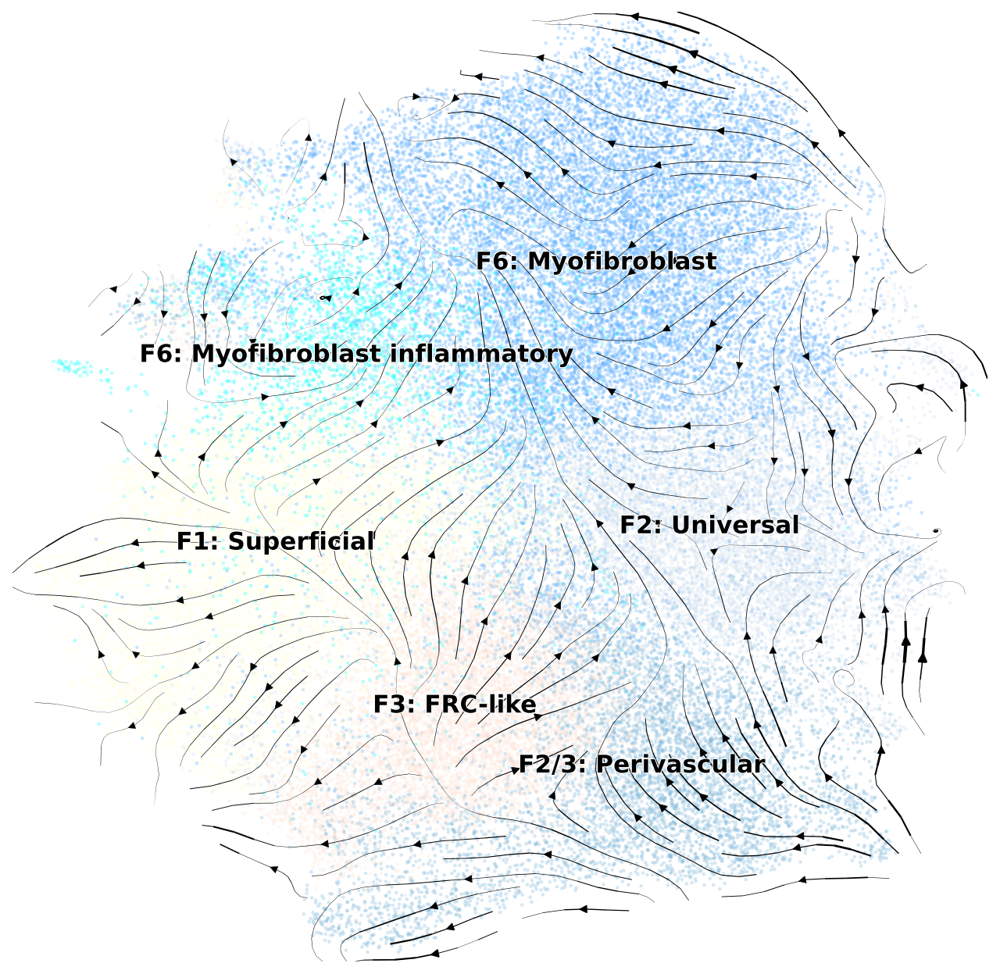

In [8]:
scv.pl.velocity_embedding_stream(
    adata, 
    basis='umap', 
    color='test2', 
    title='', 
    density=1.5  ,
    save="SUPP_fig5c_velocity.pdf",
    legend_loc=None
    
)

 

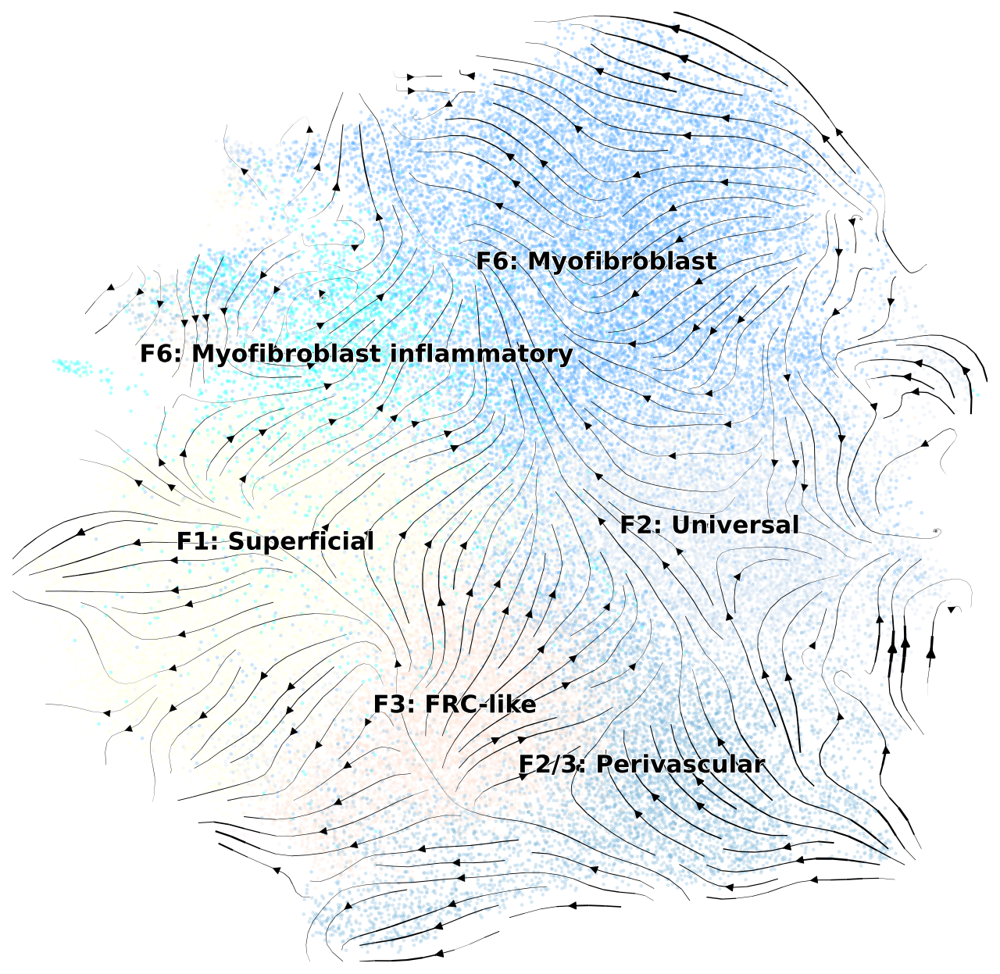

In [9]:
scv.pl.velocity_embedding_stream(
    adata, 
    basis='umap', 
    color='test2', 
    title='', 
    density=2  ,
   # save="SUPP_fig5c_velocity.pdf",
    legend_loc=None
    
)

 


# VELOCITY KERNEL

In [10]:
vk = cr.kernels.VelocityKernel(adata)
vk.compute_transition_matrix()


100%|██████████| 55826/55826 [00:27<00:00, 2062.97cell/s]


VelocityKernel[n=55826, model='deterministic', similarity='correlation', softmax_scale=9.613]

In [11]:
# vk.plot_projection(color=['test13'], s=50, title='', save="_velocityembedding.pdf")
# plt.show()

In [12]:
# #plt.rcParams['axes.grid'] = False
# vk.plot_projection(color=['test2'], s=50, title='', save="_velocityembedding.pdf")
# plt.show()

figure cannot be saved as pdf, using png instead (can only output finite numbers in pdf).
saving figure to file fig5/scvelo_fig5c_velocityembedding_nolabels.png


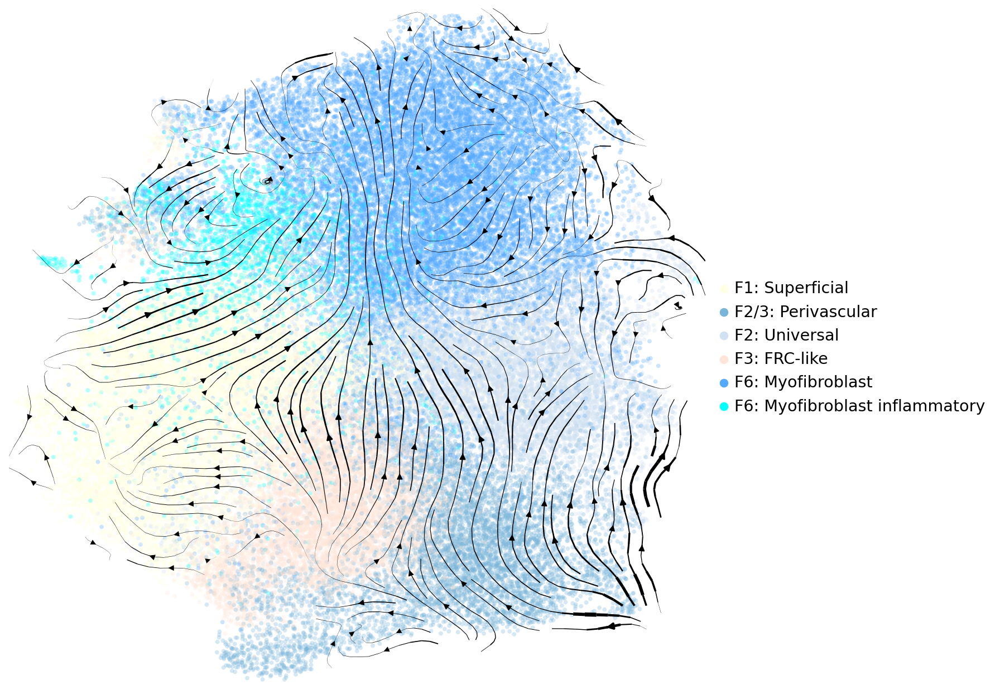

In [13]:

vk.plot_projection(color=['test2'], s=50, title='',
                   linewidth=2,
                   save="fig5c_velocityembedding_nolabels.pdf", legend_loc="right")
plt.show()

figure cannot be saved as pdf, using png instead (can only output finite numbers in pdf).
saving figure to file fig5/scvelo_fig5c_velocityembedding_nolabels.png


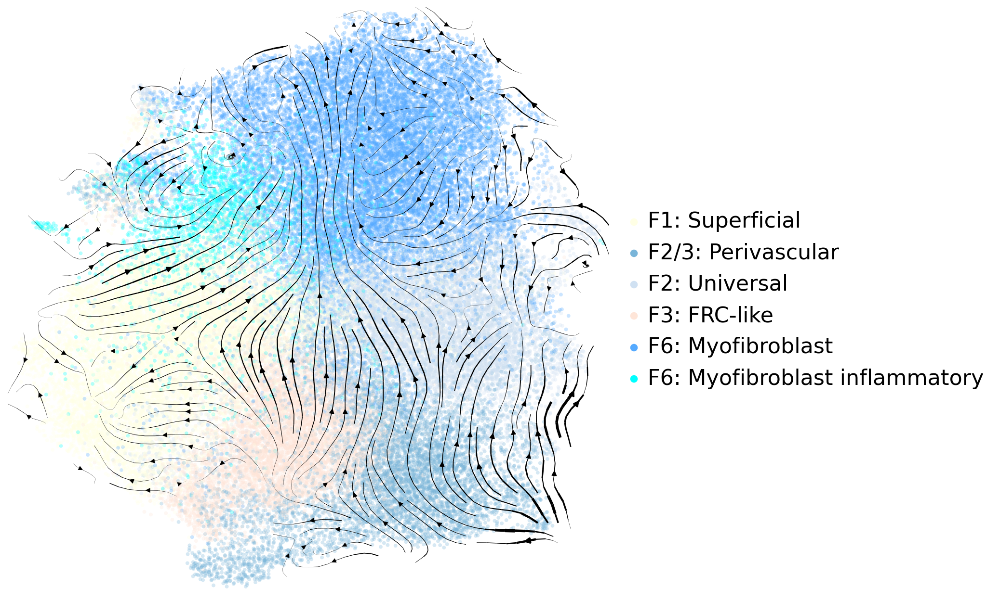

In [14]:

vk.plot_projection(color=['test2'], s=50, title='',
                   linewidth=2,
                   save="fig5c_velocityembedding_nolabels.pdf", legend_loc="right", legend_fontoutline=2,
                   legend_fontsize=20)
plt.show()

figure cannot be saved as pdf, using png instead (can only output finite numbers in pdf).
saving figure to file fig5/scvelo_fig5c_velocityembedding_nolabels.png


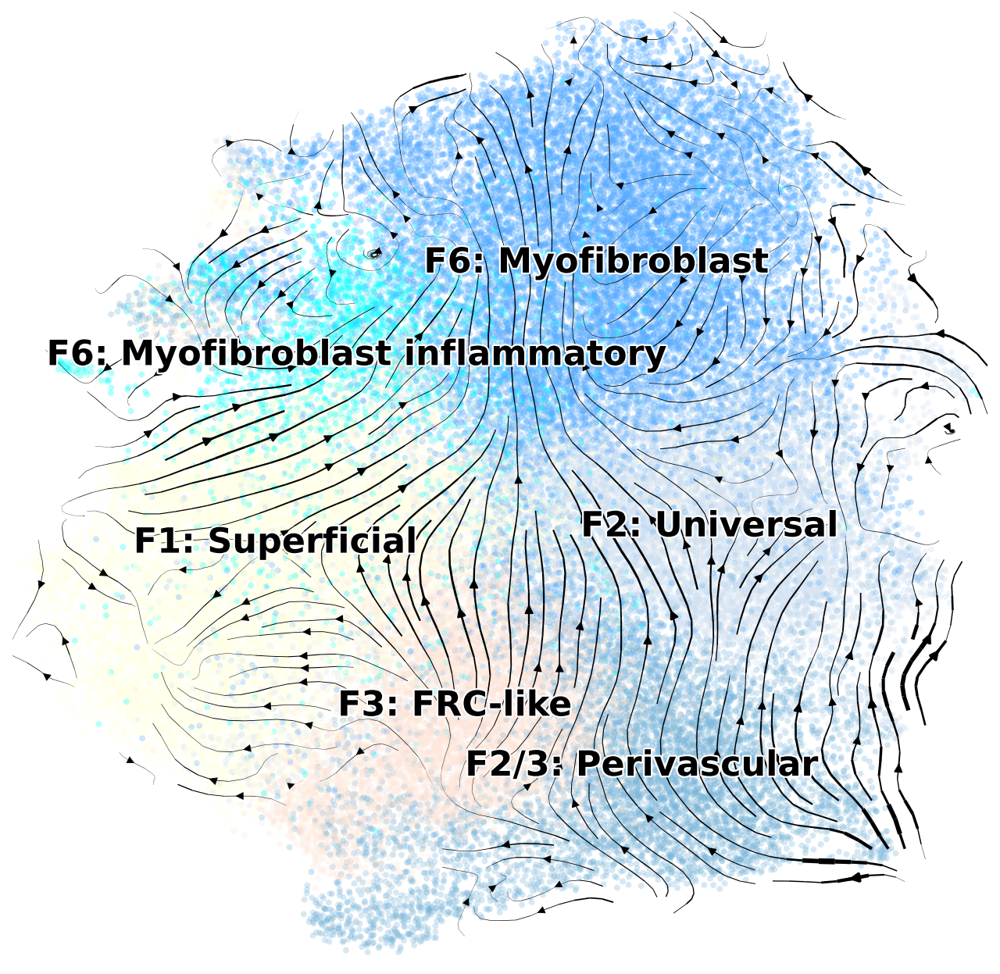

In [15]:

vk.plot_projection(color=['test2'], s=50, title='',
                   linewidth=2,
                   save="fig5c_velocityembedding_nolabels.pdf", legend_loc=None, legend_fontoutline=2,
                   legend_fontsize=20)
plt.show()

figure cannot be saved as pdf, using png instead (can only output finite numbers in pdf).
saving figure to file fig5/scvelo_fig5c_velocityembedding_nolabels2.png


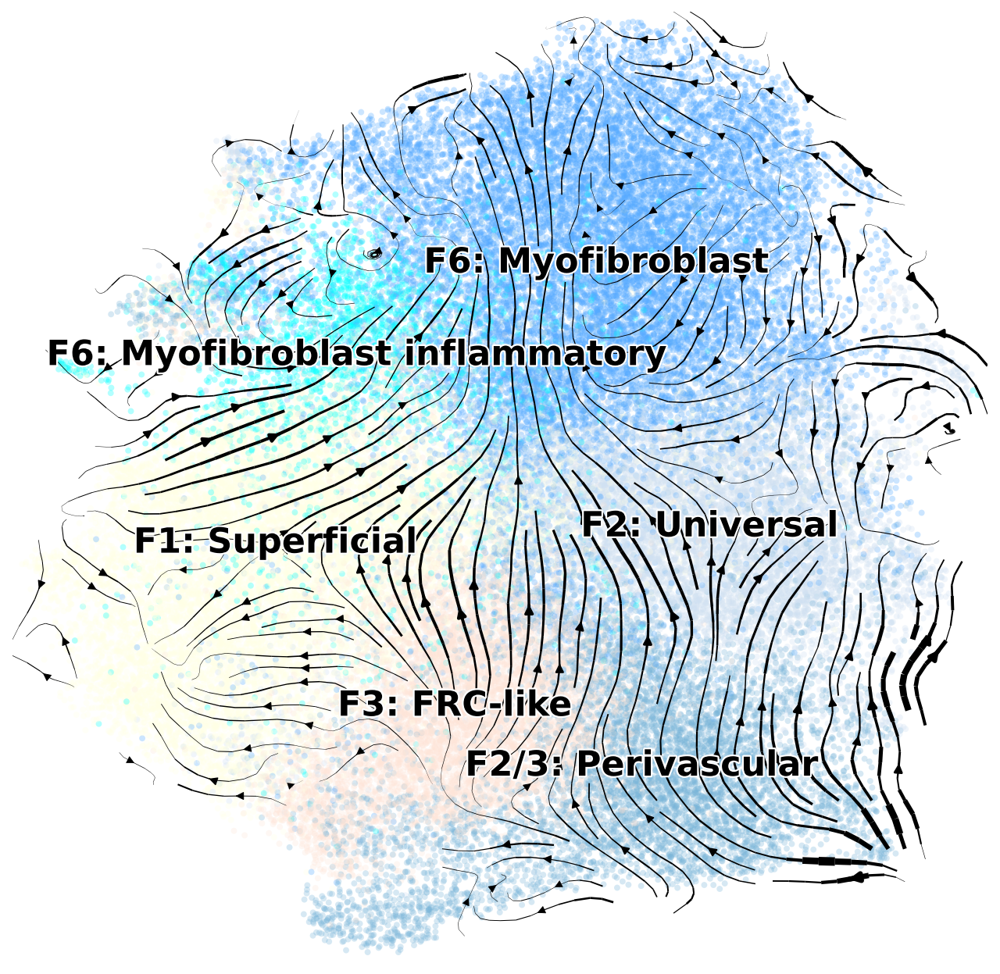

In [16]:

vk.plot_projection(color=['test2'], s=50, title='',
                   linewidth=3,
                   save="fig5c_velocityembedding_nolabels2.pdf", legend_loc="on data",
                  legend_fontoutline=2, legend_fontsize=20
                  )
plt.show()

figure cannot be saved as pdf, using png instead (can only output finite numbers in pdf).
saving figure to file fig5/scvelo_fig5c_velocityembedding_nolabels2.png


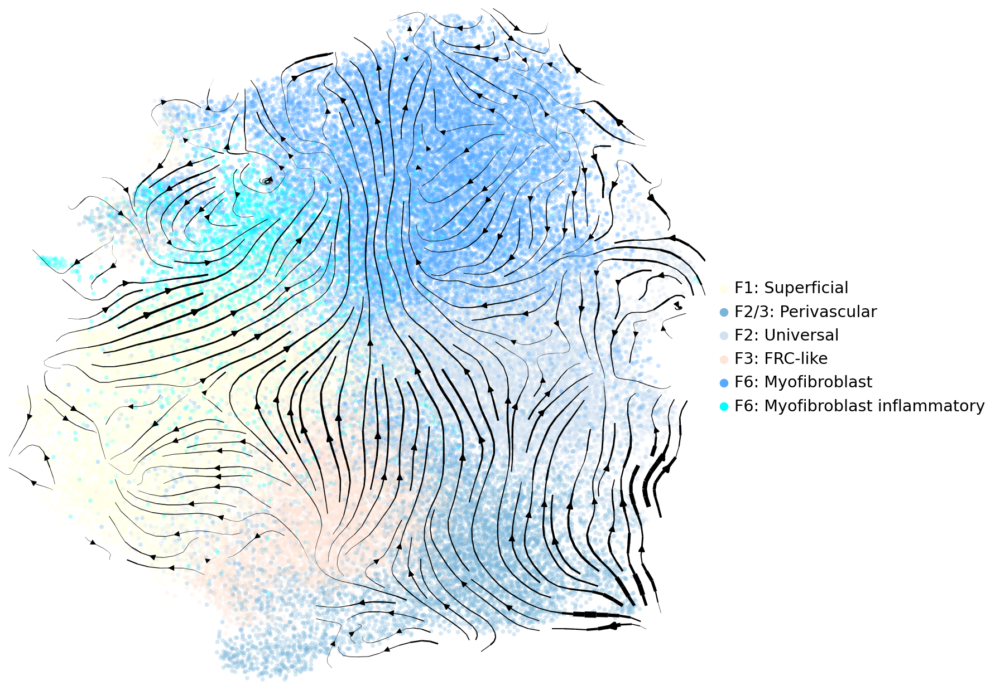

In [17]:

vk.plot_projection(color=['test2'], s=50, title='',
                   linewidth=3,
                   save="fig5c_velocityembedding_nolabels2.pdf", legend_loc="right")
plt.show()

figure cannot be saved as pdf, using png instead (can only output finite numbers in pdf).
saving figure to file fig5/scvelo_fig5c_velocityembedding_nolabels.png


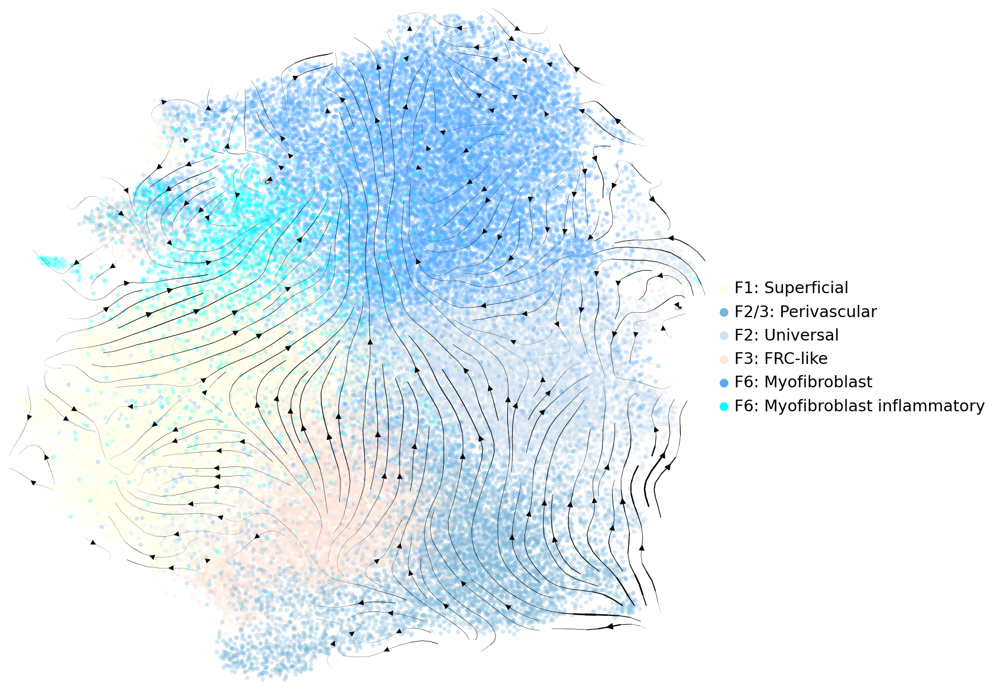

In [18]:
vk.plot_projection(color=['test2'], s=50, title='', save="fig5c_velocityembedding_nolabels.pdf", legend_loc="right")
plt.show()

In [19]:
# vk.plot_projection(color=['test2'], s=50, title='', save="_velocityembedding_nolabels.pdf", legend_loc="right",
#                   density=1, linewidth=2)
# plt.show()

In [20]:
# vk.plot_projection(color=['test2'], s=50, title='', #save="_velocityembedding_nolabels.pdf",
                   
#                    legend_loc="right",
#                   density=1.2, linewidth=3)
# plt.show()

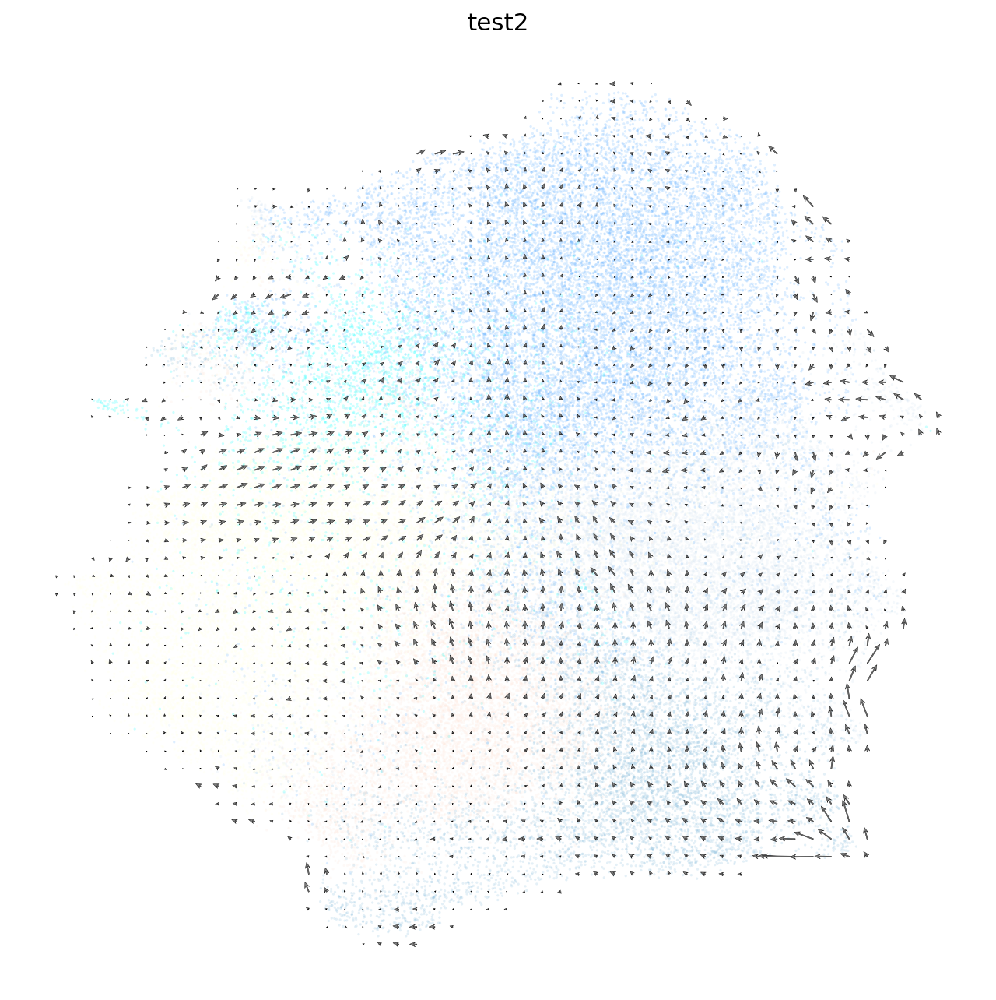

In [21]:
ax = vk.plot_projection(color=['test2'], stream=False)


In [22]:
sc.pp.neighbors(adata,  n_neighbors=30, use_rep="X_scvi")

In [23]:
# scv.pl.velocity_graph(adata, threshold=0.1, color='test2')


In [24]:
scv.tl.velocity_pseudotime(adata)
                              # save="fig5a_pseudotime.pdf")
#plt.savefig("velocity_pseudotime_umap.pdf", dpi=300, bbox_inches="tight", format="pdf")


computing terminal states
    identified 1 region of root cells and 1 region of end points .
    finished (0:00:08) --> added
    'root_cells', root cells of Markov diffusion process (adata.obs)
    'end_points', end points of Markov diffusion process (adata.obs)


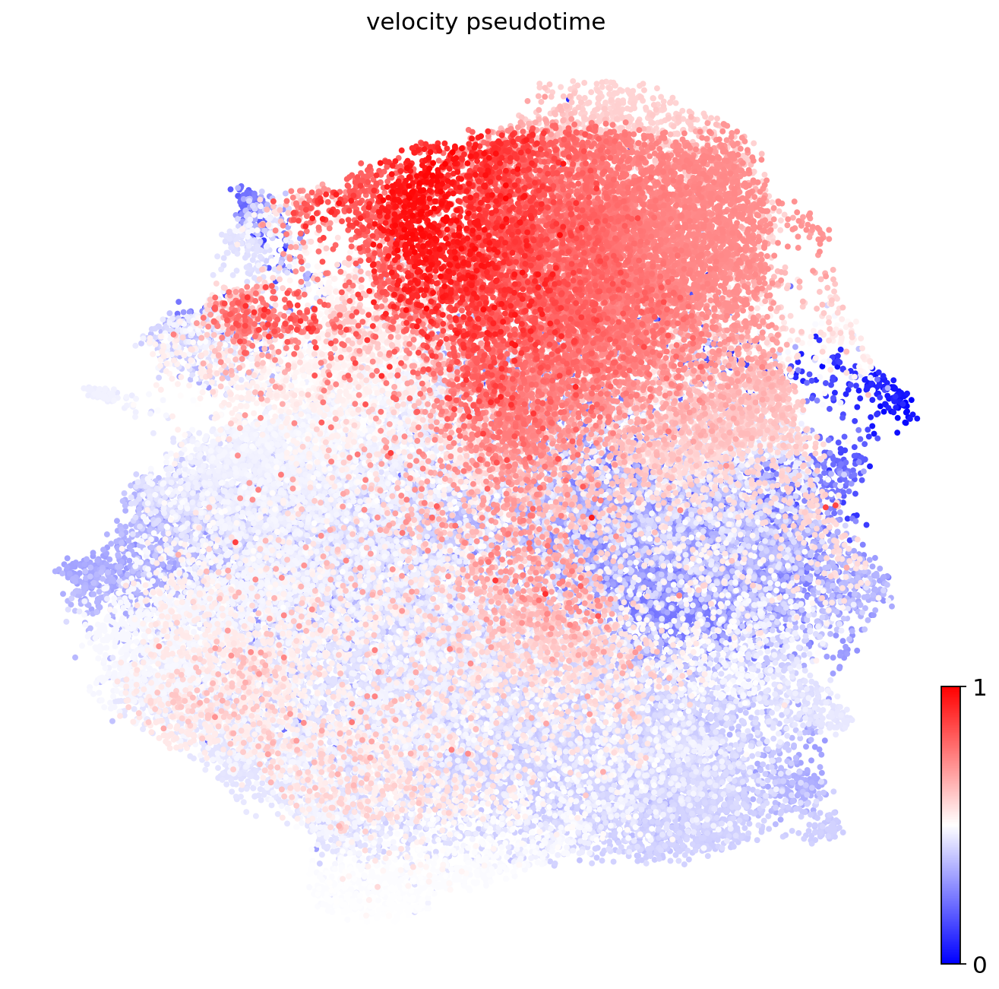

<Figure size 800x800 with 0 Axes>

In [25]:
scv.pl.scatter(adata, color="velocity_pseudotime", basis="umap",
               s=50,
               cmap="bwr")

plt.savefig("fig5/fig5a_velocity_pseudotime_umap.pdf", dpi=300, bbox_inches="tight", format="pdf")
plt.show()

In [26]:
adata.uns['neighbors']['distances'] = adata.obsp['distances']
adata.uns['neighbors']['connectivities'] = adata.obsp['connectivities']
scv.tl.paga(adata, groups='test2')

running PAGA using priors: ['velocity_pseudotime']
    finished (0:00:11) --> added
    'paga/connectivities', connectivities adjacency (adata.uns)
    'paga/connectivities_tree', connectivities subtree (adata.uns)
    'paga/transitions_confidence', velocity transitions (adata.uns)


saving figure to file fig5/scvelo_fig5b_paga_nolabels_V2.pdf


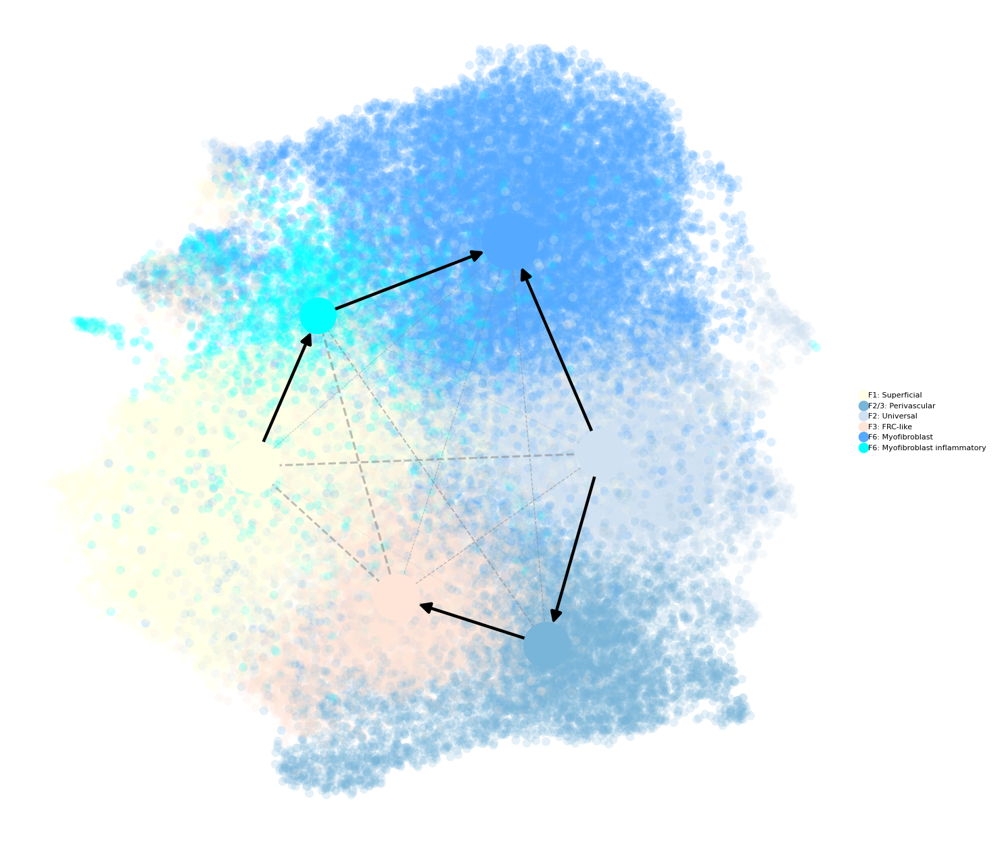

In [27]:
scv.pl.paga(adata, basis='umap', size=140, alpha=.2,
            min_edge_width=2, node_size_scale=6,
               edgecolor='black',   
            linewidth=5  ,     
           normalize_to_color=True,
          #  edge_width_scale=5
           # legend_loc="on data",
            title="",
            legend_fontoutline=2,
            legend_fontsize=5,
            fontoutline=2,
            fontsize=8,
            
           save="fig5b_paga_nolabels_V2.pdf"
           )